## Training and evaluation of different models

#### Import libraries and external functions

Only for notebooks

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import sys
sys.path.append('/'.join(sys.path[0].split('/')[:-1]))

import xarray as xr
import matplotlib.pyplot as plt
import numpy as np
import time
import os
import healpy as hp
import random
import pickle
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import cm, colors


import torch
from torch import nn, optim
from torch.utils.data import Dataset, DataLoader

from modules.utils import init_device
from modules.healpix_models import UNetSphericalHealpix, UNetSphericalTempHealpix, Conv1dAuto, \
UNetSphericalHealpixResidual, _compute_laplacian_healpix, ConvBlock, ConvCheb, UNetSphericalHealpixResidual_2
from modules.architectures import UNetSphericalHealpixResidualShort3LevelsOnlyEncoder
from modules.test import compute_rmse_healpix
from modules.plotting import plot_rmses
from modules.full_pipeline import load_data_split, WeatherBenchDatasetXarrayHealpixTemp, \
                                  train_model_2steps, create_iterative_predictions_healpix_temp, \
                                  compute_errors, plot_climatology
from modules.plotting import plot_general_skills, plot_benchmark, plot_skillmaps, plot_benchmark_simple
from modules.data import hp_to_equiangular
from modules.mail import send_info_mail


import warnings
warnings.filterwarnings("ignore")

Define paths and create directories if required

In [3]:
datadir = "../data/healpix/"
input_dir = datadir + "5.625deg_nearest/"
model_save_path = datadir + "models/"
pred_save_path = datadir + "predictions/"
prediction_path = '../data/healpix/predictions/'

if not os.path.isdir(model_save_path):
    os.mkdir(model_save_path)
    
if not os.path.isdir(pred_save_path):
    os.mkdir(pred_save_path)

Define constants and load data

In [4]:
chunk_size = 521

train_years = ('1990', '2012')#('1979', '2012')
val_years = ('2013', '2016')
test_years = ('2017', '2018')

nodes = 12*16*16
max_lead_time = 5*24
nb_timesteps = 2

os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="2"
gpu = [0]
num_workers = 10
pin_memory = True

nb_epochs = 2
learning_rate = 8e-3

obs = xr.open_mfdataset(pred_save_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})
rmses_weyn = xr.open_dataset(datadir + 'metrics/rmses_weyn.nc')

#### Data

Load data, define dynamic dataset and separate into train, validation and test

In [5]:
ds_train, ds_valid, ds_test = load_data_split(input_dir, train_years, val_years, test_years, chunk_size)

In [6]:
constants = xr.open_dataset(f'{input_dir}constants/constants_5.625deg_standardized.nc')

orog = constants['orog']
lsm = constants['lsm']
lats = constants['lat2d']
slt = constants['slt']

num_constants = len([orog, lats, lsm, slt])

train_mean_ = xr.open_mfdataset(f'{input_dir}mean_train_features_dynamic.nc')
train_std_ = xr.open_mfdataset(f'{input_dir}std_train_features_dynamic.nc')

Define model parameters

In [7]:
len_sqce = 2
# define time resolution
delta_t = 6

# predict 5days data
max_lead_time = 5*24
in_features = 7
out_features = 2

In [8]:
architecture_name = "loss_v0_residual_only_enc_l3_4epochs"
description = "all_const_len{}_delta_{}_architecture_".format(len_sqce, delta_t) + architecture_name

model_filename = model_save_path + description + ".h5"
pred_filename = pred_save_path +  description + ".nc"
rmse_filename = datadir + 'metrics/rmse_' + description + '.nc'

In [9]:
metrics_path = '../data/healpix/metrics/'
figures_path = '../data/healpix/figures/' + description + '/'


In [10]:
if not os.path.isdir(figures_path):
    os.mkdir(figures_path)

**Comments**:

architecture_name = "loss_five_steps_progressive"

```python
def update_w(w):
for i in range(1,5):
    w[5 - i] += w[5 - i -1]*0.25
    w[5 - i - 1] *= 0.5
w = np.array(w)/sum(w)
return w
```
    
architecture_name = "loss_five_steps_progressive_v2"
    
```python
def update_w(w):
for i in range(1,5):
    if (w[5 - i] + 1e-3) <  w[5 - i -1]:
        w[5 - i] += w[5 - i -1]*0.1
w = np.array(w)/sum(w)
return w
```

update 3:

```python
def update_w(w):
    for i in range(1,5):
        w[5 - i] += w[5 - i -1]*0.25
        w[5 - i - 1] *= 0.9
    w[0] = max(w[0], 0.4)
    w = np.array(w)/sum(w)
    return w

```
    
loss_v0:


```python
def update_w(w):
    for i in range(1,5):
        w[5 - i] += w[5 - i -1]*0.25
        w[5 - i - 1] *= 0.5
    w = np.array(w)/sum(w)
    return w

```
    

Generate dataloader

In [11]:
class WeatherBenchDatasetXarrayHealpixTempMultiple(Dataset):
    
    """ Dataset used for graph models (1D), where data is loaded from stored numpy arrays.
    
    Parameters
    ----------
    ds : xarray Dataset
        Dataset containing the input data
    out_features : int
        Number of output features
    delta_t : int
        Temporal spacing between samples in temporal sequence (in hours)
    len_sqce : int
        Length of the input and output (predicted) sequences
    years : tuple(str)
        Years used to split the data
    nodes : float
        Number of nodes each sample has
    max_lead_time : int
        Maximum lead time (in case of iterative predictions) in hours
    load : bool
        If true, load dataset to RAM
    mean : np.ndarray of shape 2
        Mean to use for data normalization. If None, mean is computed from data
    std : np.ndarray of shape 2
        std to use for data normalization. If None, mean is computed from data
    """
        
    def __init__(self, ds, out_features, delta_t, len_sqce_input, len_sqce_output, years, nodes, nb_timesteps, 
                 max_lead_time=None, load=True, mean=None, std=None, requires_st=None):
        
        
        self.delta_t = delta_t
        self.len_sqce = len_sqce_input
        self.len_output = len_sqce_output
        self.years = years
        
        self.nodes = nodes
        self.out_features = out_features
        self.max_lead_time = max_lead_time
        self.nb_timesteps = nb_timesteps
        
        self.data = ds.to_array(dim='level', name='Dataset').transpose('time', 'node', 'level')
        self.in_features = self.data.shape[-1]
        
        self.mean = self.data.mean(('time', 'node')).compute() if mean is None else mean
        self.std = self.data.std(('time', 'node')).compute() if std is None else std
        
        eps = 0.001 #add to std to avoid division by 0
        
        # Count total number of samples
        total_samples = self.data.shape[0]        
        
        if max_lead_time is None:
            self.n_samples = total_samples - (len_sqce_output+1) * delta_t
        else:
            self.n_samples = total_samples - (len_sqce_output+1) * delta_t - max_lead_time
        
        # Normalize

        if requires_st:
            self.data = self.data.groupby('time.month') - self.mean.to_array(dim='level')
            self.data = self.data.groupby('time.month') / self.std.to_array(dim='level')
            self.data.compute()
        else:
            self.data = (self.data - self.mean.to_array(dim='level')) / (
                        self.std.to_array(dim='level') + eps)
        self.data.persist()
        
        self.idxs = np.array(range(self.n_samples))
        
        print('Loading data to RAM...')
        t = time.time()
        self.data.load()
        print('Time: {:.2f}s'.format(time.time() - t))
        
        
    def __len__(self):
        return self.n_samples
    
    def __getitem__(self, idx):
        """ Returns sample and label corresponding to an index as torch.Tensor objects
            The return tensor shapes are (for the sample and the label): [n_vertex, len_sqce, n_features]
            
        """
        idx_data = idx
        idx_full = np.concatenate(np.array([[idx_data + self.delta_t*k] for k in range(self.len_sqce + self.len_output)])).reshape(-1)
        dat = self.data.isel(time=idx_full).values
        
        
        X = (
            torch.tensor(dat[:len(idx)*self.len_sqce,:,:] , \
                         dtype=torch.float).reshape(len(idx)*self.len_sqce, self.nodes, -1),
        )
        
        y = [
            
            torch.tensor(dat[len(idx)*(self.len_sqce + k -1 ):len(idx)*(self.len_sqce + k +1), :, :], \
                         dtype=torch.float).reshape(len(idx)*self.len_sqce, self.nodes, -1)
            for k in range(self.len_output)
        ]
        return X, y

In [12]:
training_ds = WeatherBenchDatasetXarrayHealpixTempMultiple(ds=ds_train, out_features=out_features, delta_t=delta_t,
                                                   len_sqce_input=len_sqce, len_sqce_output=5, max_lead_time=max_lead_time,
                                                   years=train_years, nodes=nodes, nb_timesteps=nb_timesteps, 
                                                   mean=train_mean_, std=train_std_)

validation_ds = WeatherBenchDatasetXarrayHealpixTempMultiple(ds=ds_valid, out_features=out_features, delta_t=delta_t,
                                                     len_sqce_input=len_sqce, len_sqce_output=5, max_lead_time=max_lead_time,
                                                     years=val_years, nodes=nodes, nb_timesteps=nb_timesteps, 
                                                     mean=train_mean_, std=train_std_)

Loading data to RAM...
Time: 35.43s
Loading data to RAM...
Time: 5.80s


#### Model

Define model, train and evaluate train and validation losses



In [13]:
spherical_unet = UNetSphericalHealpixResidualShort3LevelsOnlyEncoder(N=nodes, in_channels=in_features*len_sqce, out_channels=out_features, kernel_size=3)
spherical_unet, device = init_device(spherical_unet, gpu=gpu)


In [14]:
batch_size = 10
epochs=4

In [15]:
iterations_per_epoch = int(np.ceil(training_ds.n_samples / batch_size))

In [16]:
constants_tensor = torch.tensor(xr.merge([orog, lats, lsm, slt], compat='override').to_array().values, \
                            dtype=torch.float)

# standardize 
constants_tensor = (constants_tensor - torch.mean(constants_tensor, dim=1).view(-1,1).expand(4, 3072)) / \
                    torch.std(constants_tensor, dim=1).view(-1,1).expand(4, 3072)

In [17]:
def update_w(w):
    for i in range(1,5):
        w[5 - i] += w[5 - i -1]*0.25
        w[5 - i - 1] *= 0.5
    w = np.array(w)/sum(w)
    return w

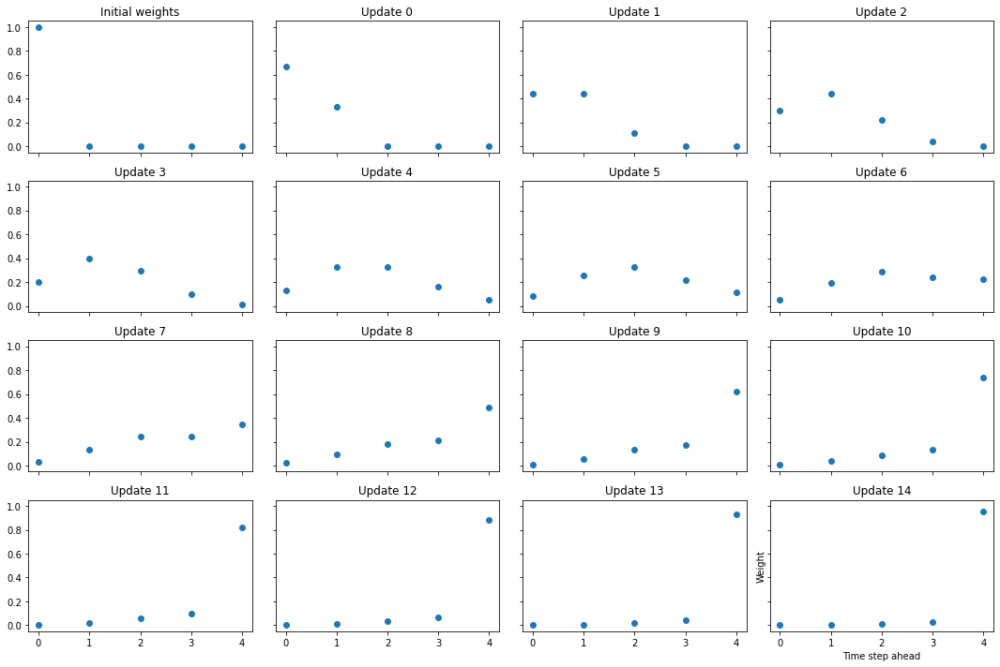

In [18]:
w = [1] + [0] * 4
f, ax = plt.subplots(4,4, figsize=(15, 10), sharex=True, sharey=True)
ax = ax.flatten()

x_vals = list(range(5))
ax[0].scatter(x_vals, w)
ax[0].set_title('Initial weights')

for i in range(15):
    w = update_w(w)
    ax[i+1].scatter(x_vals, w)
    ax[i+1].set_title('Update ' + str(i))
    
plt.xlabel('Time step ahead')
plt.ylabel('Weight')
plt.tight_layout()
plt.savefig(figures_path + 'weight_updates.png')
plt.show()  

In [19]:
def train_model_multiple_steps(model, device, training_ds, len_output, constants, batch_size, epochs, lr, validation_ds):
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=lr, eps=1e-7, weight_decay=0, amsgrad=False)

    train_losses = []
    val_losses = []
    n_samples = training_ds.n_samples
    n_samples_val = validation_ds.n_samples
    num_nodes = training_ds.nodes
    num_constants = constants.shape[1]
    out_features = training_ds.out_features
    num_in_features = training_ds.in_features + num_constants

    constants_expanded = constants.expand(batch_size, num_nodes, num_constants)
    constants1 = constants_expanded.to(device)
    idxs_val = validation_ds.idxs
    
    #initially give full weight to first output
    weights_loss =[1] + [0] * 4
    weight_variations = [(weights_loss, 0, 0)]
    count_upd = 0
    train_loss_steps = {}
    for step_ahead in range(len_output):
        train_loss_steps['t{}'.format(step_ahead)] = []
        
    threshold = 1e-4

    for epoch in range(epochs):

        print('\rEpoch : {}'.format(epoch), end="")

        time1 = time.time()

        val_loss = 0
        train_loss = 0

        model.train()

        random.shuffle(training_ds.idxs)
        idxs = training_ds.idxs

        batch_idx = 0
        train_loss_it = []
        times_it = []
        t0 = time.time()
        for i in range(0, n_samples - batch_size, batch_size):
            i_next = min(i + batch_size, n_samples)

            if len(idxs[i:i_next]) < batch_size:
                constants_expanded = constants.expand(len(idxs[i:i_next]), num_nodes, num_constants)
                constants1 = constants_expanded.to(device)

            batch, labels = training_ds[idxs[i:i_next]]

            # Transfer to GPU
            batch_size = batch[0].shape[0] // 2
            
            batch1 = torch.cat((batch[0][:batch_size, :, :], \
                                constants_expanded, batch[0][batch_size:, :, :], constants_expanded), dim=2).to(device)
            
            # generate predictions multiple steps ahead sequentially
            output = model(batch1)
            label1 = labels[0].to(device)
            l0 = criterion(output, label1[batch_size:, :, :out_features])
            loss_ahead = weights_loss[0] * l0
            train_loss_steps['t0'].append(l0.item())
            
            for step_ahead in range(1, len_output):
                # input t-2
                inp_t2 = batch1[:, :, num_in_features:]
                
                # toa at t-1
                toa_delta = labels[step_ahead][:batch_size, :, -1].view(-1, num_nodes, 1).to(device)
                batch1 = torch.cat((inp_t2, output, toa_delta, constants1), dim=2)
                
                output = model(batch1)
                label1 = labels[step_ahead].to(device)
                l0 = criterion(output, label1[batch_size:, :, :out_features])
                loss_ahead += weights_loss[step_ahead] * l0
                train_loss_steps['t{}'.format(step_ahead)].append(l0.item())
                
            
            optimizer.zero_grad()
            loss_ahead.backward()
            optimizer.step()

            train_loss += loss_ahead.item() * batch_size
            train_loss_it.append(train_loss / (batch_size * (batch_idx + 1)))
            if len(train_loss_it) > 5:
                if (np.std(train_loss_it[-10:]) < threshold) and count_upd > 2e2:
                    weights_loss = update_w(weights_loss)
                    count_upd = 0
                    #print('New weights ', weights_loss, ' Epoch {} Iter {}'.format(epoch, i))
                    weight_variations.append((weights_loss, epoch, len(train_loss_steps['t0'])))
                    threshold /= 10
                else:
                    count_upd += 1
                    
            times_it.append(time.time() - t0)
            t0 = time.time()

            if batch_idx % 50 == 0:
                print('\rBatch idx: {}; Loss: {:.3f} - Other {:.5f} - {}'\
                      .format(batch_idx, train_loss / (batch_size * (batch_idx + 1)), np.std(train_loss_it[-10:]), count_upd),
                      end="")
            batch_idx += 1

        train_loss = train_loss / n_samples
        train_losses.append(train_loss)

        model.eval()

        constants1 = constants_expanded.to(device)
        with torch.set_grad_enabled(False):
            index = 0

            for i in range(0, n_samples_val - batch_size, batch_size):
                i_next = min(i + batch_size, n_samples_val)

                if len(idxs_val[i:i_next]) < batch_size:
                    constants_expanded = constants.expand(len(idxs_val[i:i_next]), num_nodes, num_constants)
                    constants1 = constants_expanded.to(device)

                batch, labels = training_ds[idxs[i:i_next]]

                # Transfer to GPU
                batch_size = batch[0].shape[0] // 2
                batch1 = torch.cat((batch[0][:batch_size, :, :], \
                                    constants_expanded, batch[0][batch_size:, :, :], constants_expanded), dim=2).to(device)

                # generate predictions multiple steps ahead sequentially
                output = model(batch1)
                label1 = labels[0].to(device)
                loss_ahead = weights_loss[0] * criterion(output, label1[batch_size:, :, :out_features]).item()

                for step_ahead in range(1, len_output):
                    # input t-2
                    inp_t2 = batch1[:, :, num_in_features:]

                    # toa at t-1
                    toa_delta = labels[step_ahead][:batch_size, :, -1].view(-1, num_nodes, 1).to(device)
                    batch1 = torch.cat((inp_t2, output, toa_delta, constants1), dim=2)

                    output = model(batch1)
                    label1 = labels[step_ahead].to(device)
                    loss_ahead += weights_loss[step_ahead] * criterion(output, label1[batch_size:, :, :out_features]).item()

                val_loss +=  loss_ahead * batch_size
                index = index + batch_size

        val_loss = val_loss / n_samples_val
        val_losses.append(val_loss)

        time2 = time.time()

        # Print stuff
        print('Epoch: {e:3d}/{n_e:3d}  - loss: {l:.3f}  - val_loss: {v_l:.5f}  - time: {t:2f}'
              .format(e=epoch + 1, n_e=epochs, l=train_loss, v_l=val_loss, t=time2 - time1))

    return train_losses, val_losses, train_loss_it, times_it, train_loss_steps, weight_variations

In [20]:
# Train model
train_losses, val_losses, train_loss_it, times_it, train_loss_steps, weight_variations = \
train_model_multiple_steps(spherical_unet, device, training_ds, 5, constants_tensor.transpose(1,0), \
                            batch_size=batch_size, epochs=epochs, lr=learning_rate, validation_ds=validation_ds)


Batch idx: 20100; Loss: 0.038 - Other 0.00000 - 8710Epoch:   1/  4  - loss: 0.038  - val_loss: 0.03312  - time: 9580.762508
Batch idx: 20100; Loss: 0.031 - Other 0.00000 - 13148Epoch:   2/  4  - loss: 0.031  - val_loss: 0.03772  - time: 9525.297534
Batch idx: 20100; Loss: 0.030 - Other 0.00000 - 33289Epoch:   3/  4  - loss: 0.030  - val_loss: 0.03034  - time: 9525.961435
Batch idx: 20100; Loss: 0.029 - Other 0.00000 - 53430Epoch:   4/  4  - loss: 0.029  - val_loss: 0.02907  - time: 9753.350474


In [21]:
# save model
torch.save(spherical_unet.state_dict(), model_filename)

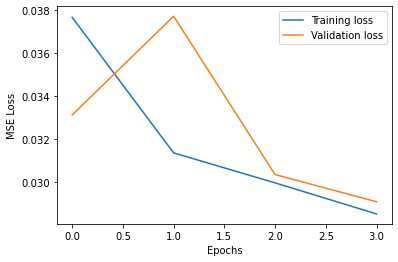

In [22]:
# Show training losses
plt.plot(train_losses, label='Training loss')
plt.plot(val_losses, label='Validation loss')
plt.xlabel('Epochs')
plt.ylabel('MSE Loss')
plt.legend()
plt.show()

del training_ds, validation_ds
torch.cuda.empty_cache()

#### Test 

Define test dataloader, generate predictions and evaluate loss

In [23]:
# Testing data
testing_ds = WeatherBenchDatasetXarrayHealpixTemp(ds=ds_test, out_features=out_features,
                                                  len_sqce=len_sqce, delta_t=delta_t, years=test_years, 
                                                  nodes=nodes, nb_timesteps=nb_timesteps, 
                                                  mean=train_mean_, std=train_std_, 
                                                  max_lead_time=max_lead_time)



Loading data to RAM...
Time: 2.71s


In [24]:
predictions, lead_times, times, nodes, out_lat, out_lon = \
create_iterative_predictions_healpix_temp(spherical_unet, device, testing_ds, constants_tensor.transpose(1,0))

Processing lead time 20 out of 20

Generate predictions ds and save it

In [25]:
das = [];
lev_idx = 0
for var in ['z', 't']:       
    das.append(xr.DataArray(
        predictions[:, :, :, lev_idx],
        dims=['lead_time', 'time', 'node'],
        coords={'lead_time': lead_times, 'time': times[:predictions.shape[1]], 'node': np.arange(nodes)},
        name=var
    ))
    lev_idx += 1

prediction_ds = xr.merge(das)
prediction_ds = prediction_ds.assign_coords({'lat': out_lat, 'lon': out_lon})

In [26]:
prediction_ds.to_netcdf(pred_filename)

Z500 - 0: 64.5791944000927
T850 - 0: 0.7154103281218952


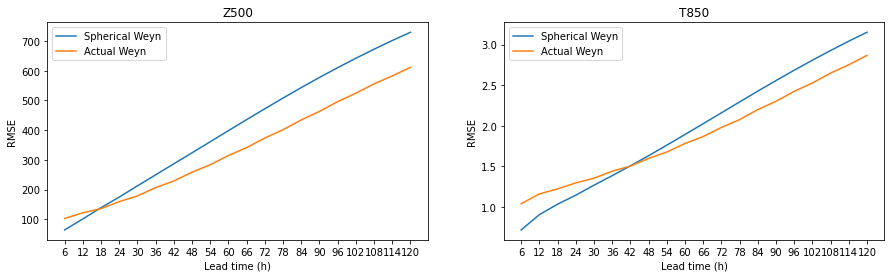

In [27]:
# Compute and save RMSE
rmse = compute_rmse_healpix(prediction_ds, obs).load()
rmse.to_netcdf(rmse_filename)

# Show RMSE
print('Z500 - 0:', rmse.z.values[0])
print('T850 - 0:', rmse.t.values[0])

plot_rmses(rmse, rmses_weyn.rename({'z500':'z', 't850':'t'}).isel(lead_time=list(range(20))), lead_time=6)

#del spherical_unet
del prediction_ds, rmse
torch.cuda.empty_cache()

#### Generate plots for evaluation

In [28]:
resolution = 5.625
lead_time = 6
start_time = len_sqce * lead_time - 6
end_time = (6-lead_time) if (6-lead_time) > 0 else None

# Data
lead_times = np.arange(lead_time, max_lead_time+lead_time, lead_time)

obs = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords')
pred = xr.open_mfdataset(prediction_path  + description + '.nc', combine='by_coords')
obs = obs.isel(time=slice(6,pred.time.shape[0]+6))

Compute errors

In [29]:
obsc = xr.open_mfdataset(prediction_path + 'observations_nearest.nc', combine='by_coords', chunks={'time':chunk_size})
predc = xr.open_mfdataset(prediction_path  + description + '.nc', combine='by_coords', chunks={'time':chunk_size})
obsc = obsc.isel(time=slice(6,pred.time.shape[0]+6))

In [30]:
t = time.time()
corr_map, rbias_map, rsd_map, rmse_map, obs_rmse, rmse_map_norm = compute_errors(predc, obsc)
print(time.time() - t)

loading data
time to load data:  63.527151346206665
time mean obs  24.887070655822754
time mean pred  31.93311333656311
time std obs  57.10146689414978
time std pred  64.56650066375732
time cov  57.96817588806152
time corre_map  0.004771709442138672
time rbias map  49.66072416305542
time rsd map  0.0037848949432373047
time rmse map  39.58248853683472
422.3821053504944


In [31]:
rmse_spherical = xr.load_dataset(metrics_path + 'rmse_' + description + '.nc')
rbias_spherical = rbias_map.mean('node').compute()
rsd_spherical = rsd_map.mean('node').compute()
corr_spherical = corr_map.mean('node').compute()

In [32]:
rbias_spherical.to_netcdf(metrics_path + 'rbias_' + description + '.nc')
rsd_spherical.to_netcdf(metrics_path + 'rsd_' + description + '.nc')
corr_spherical.to_netcdf(metrics_path + 'corr_' + description + '.nc')

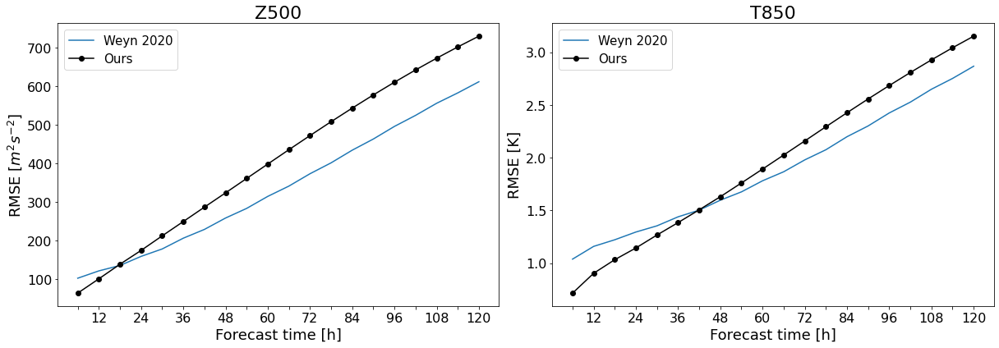

In [33]:
plot_benchmark_simple(rmse_spherical, description, lead_times, 
               input_dir=metrics_path, output_dir=figures_path, title=False)

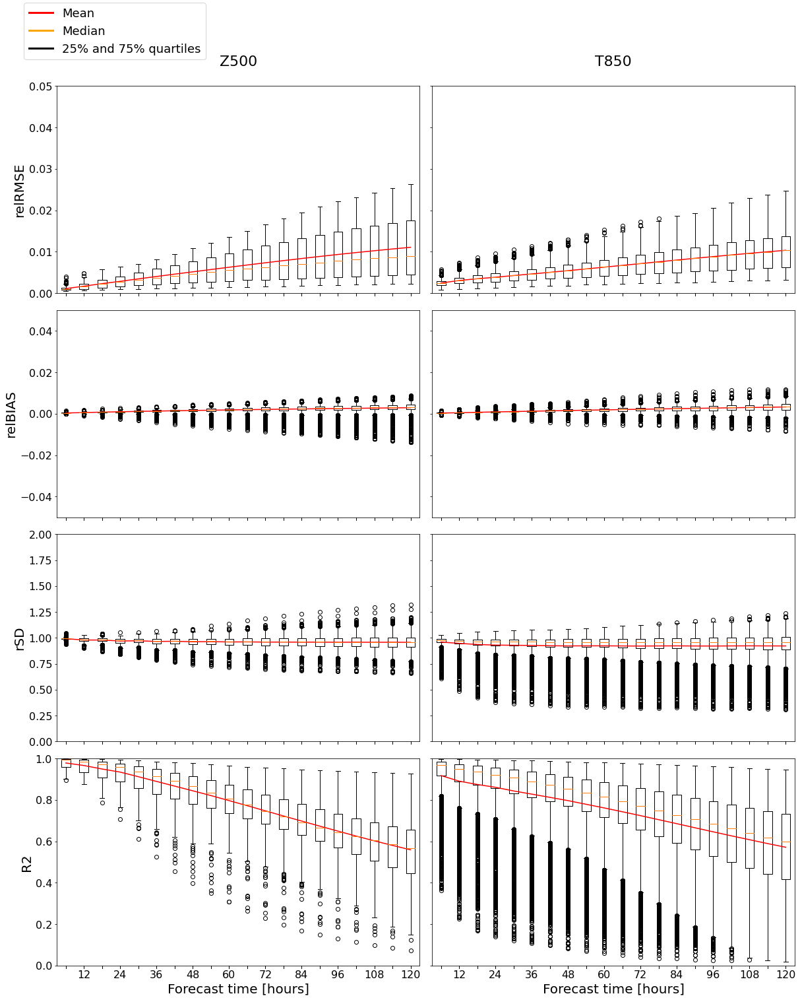

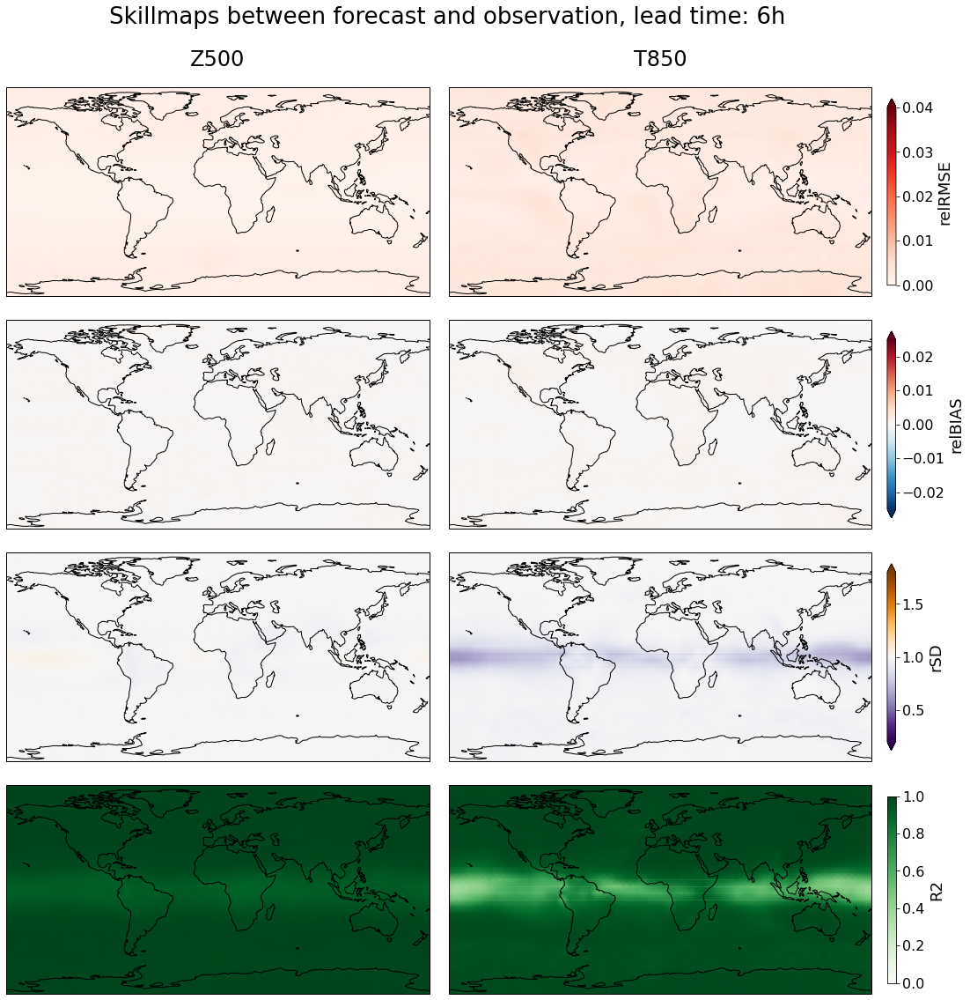

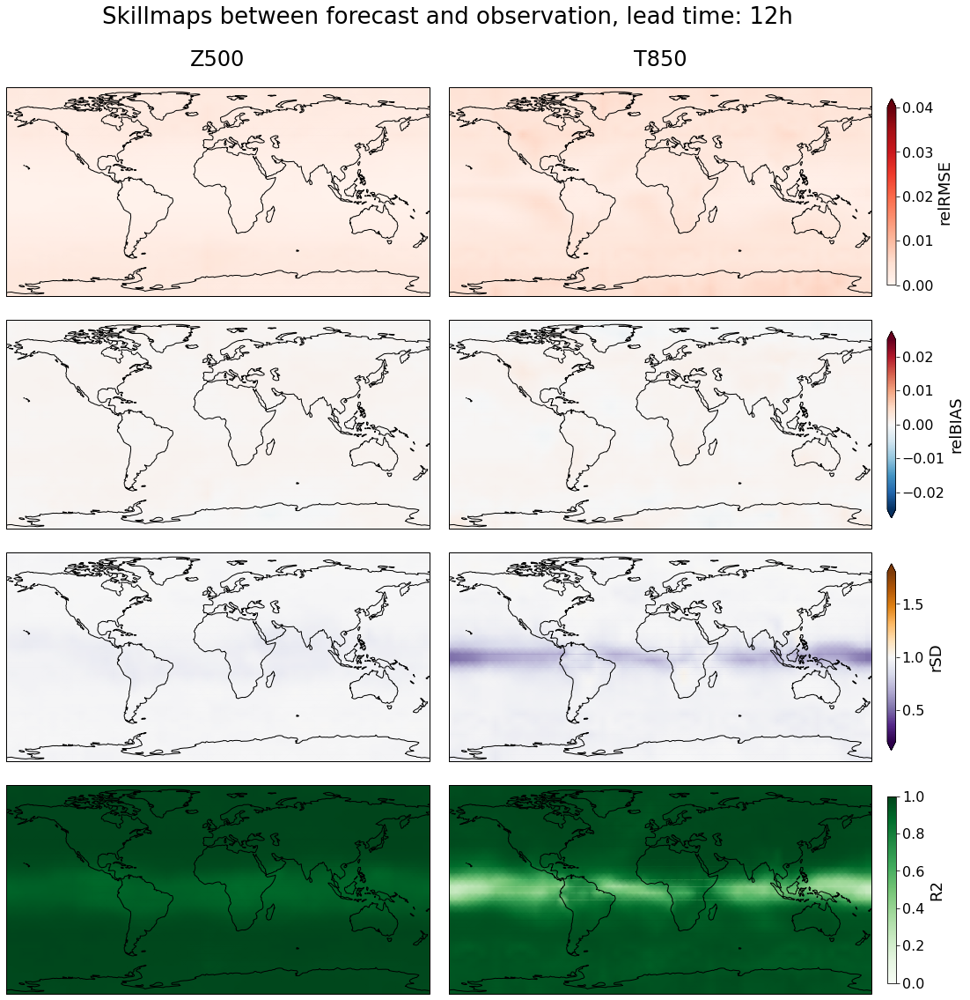

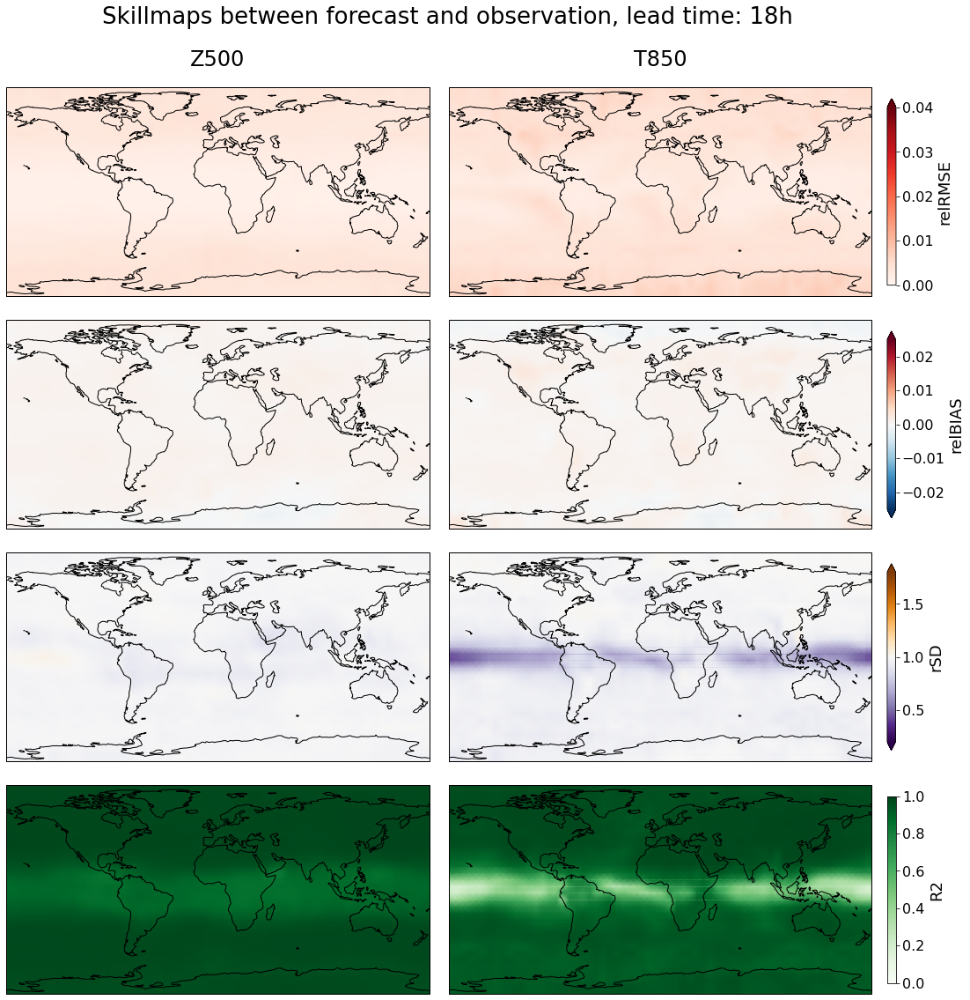

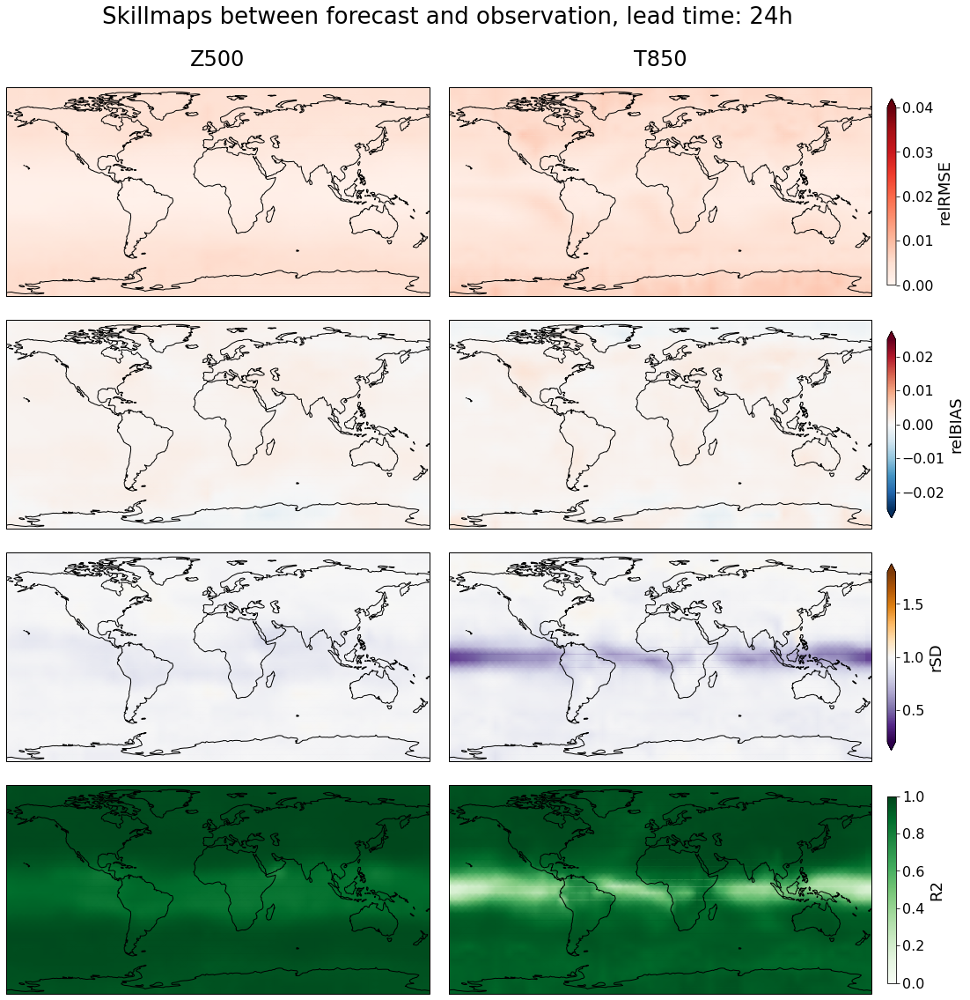

...

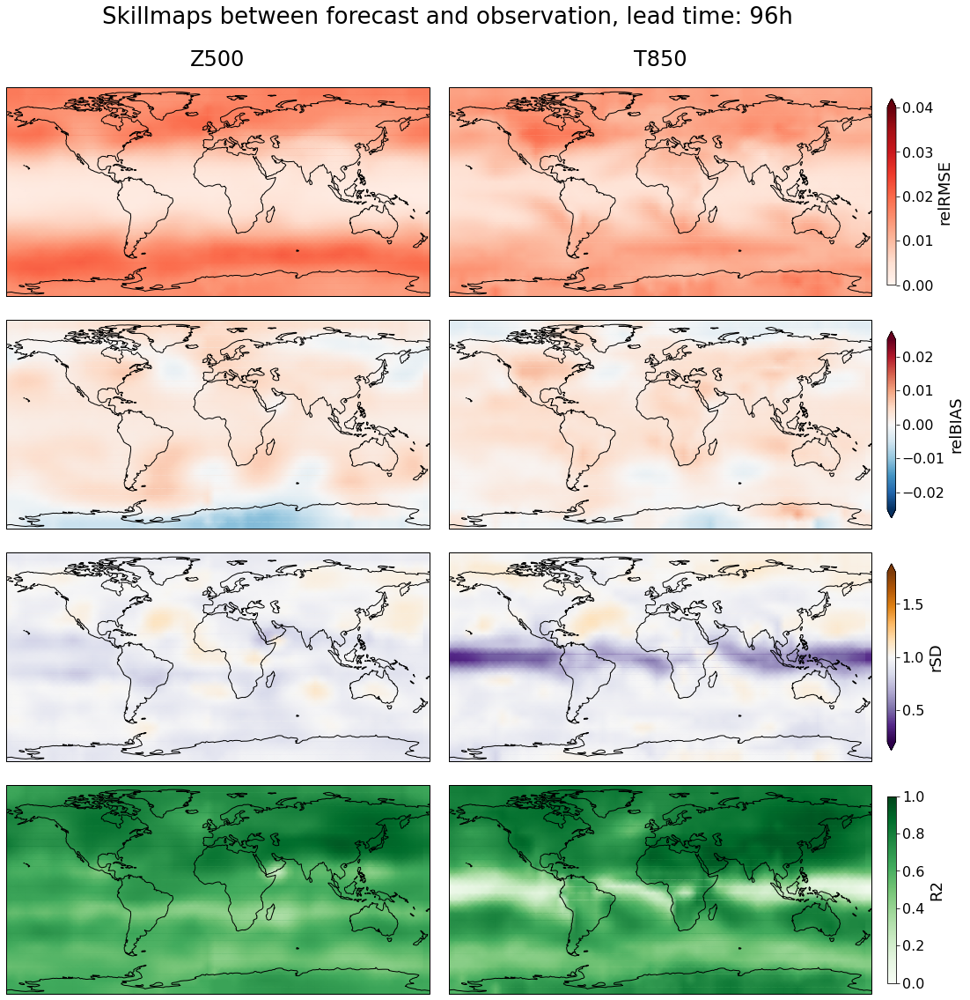

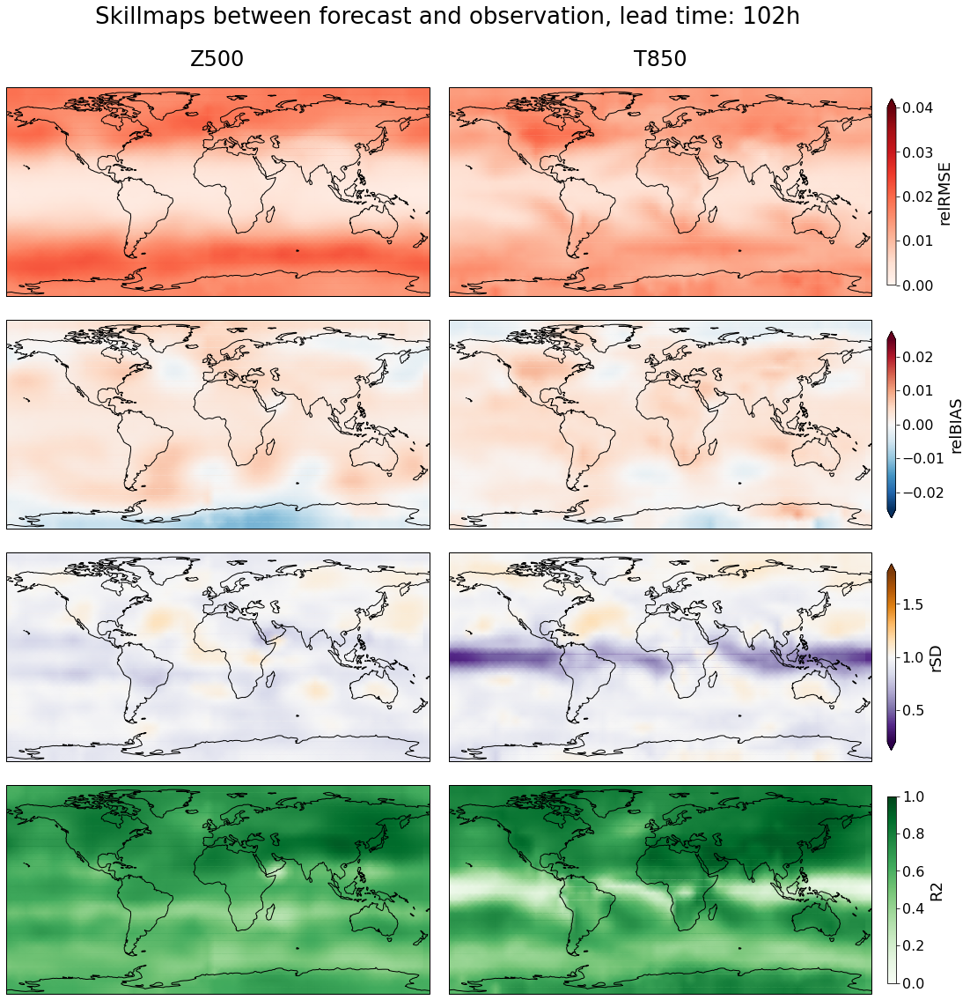

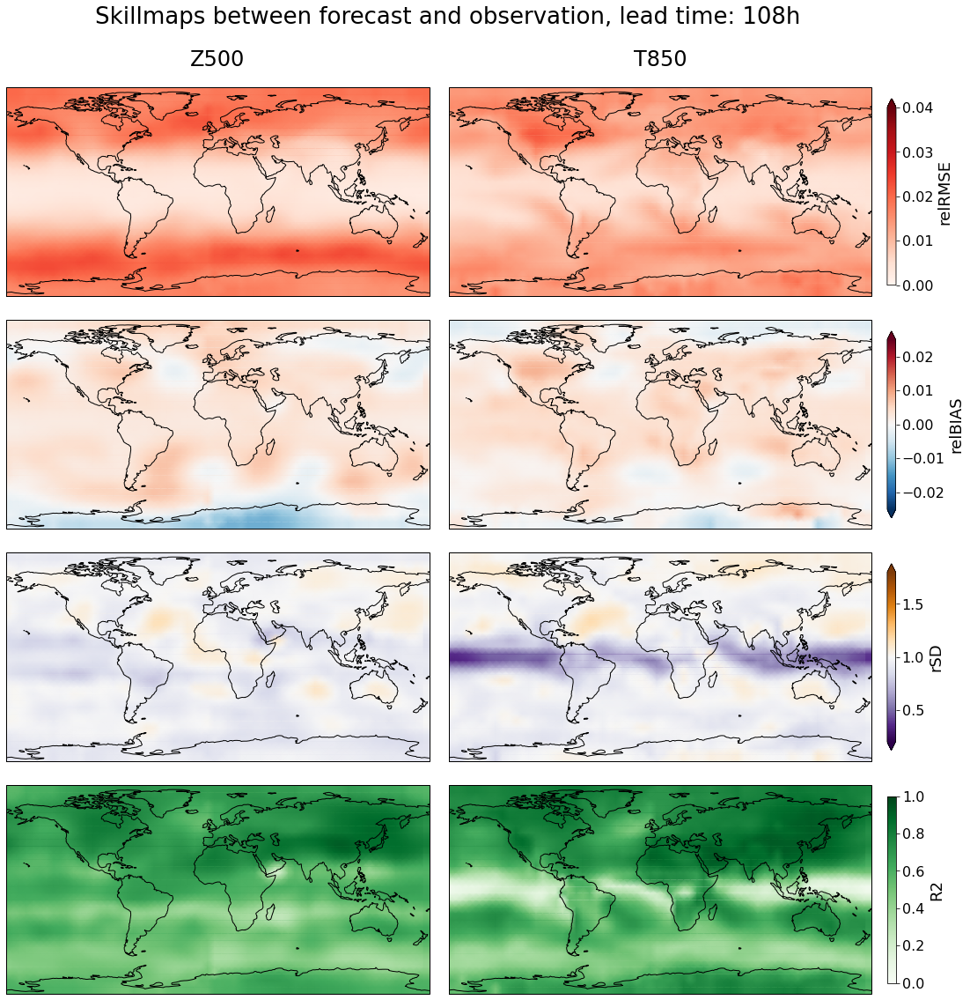

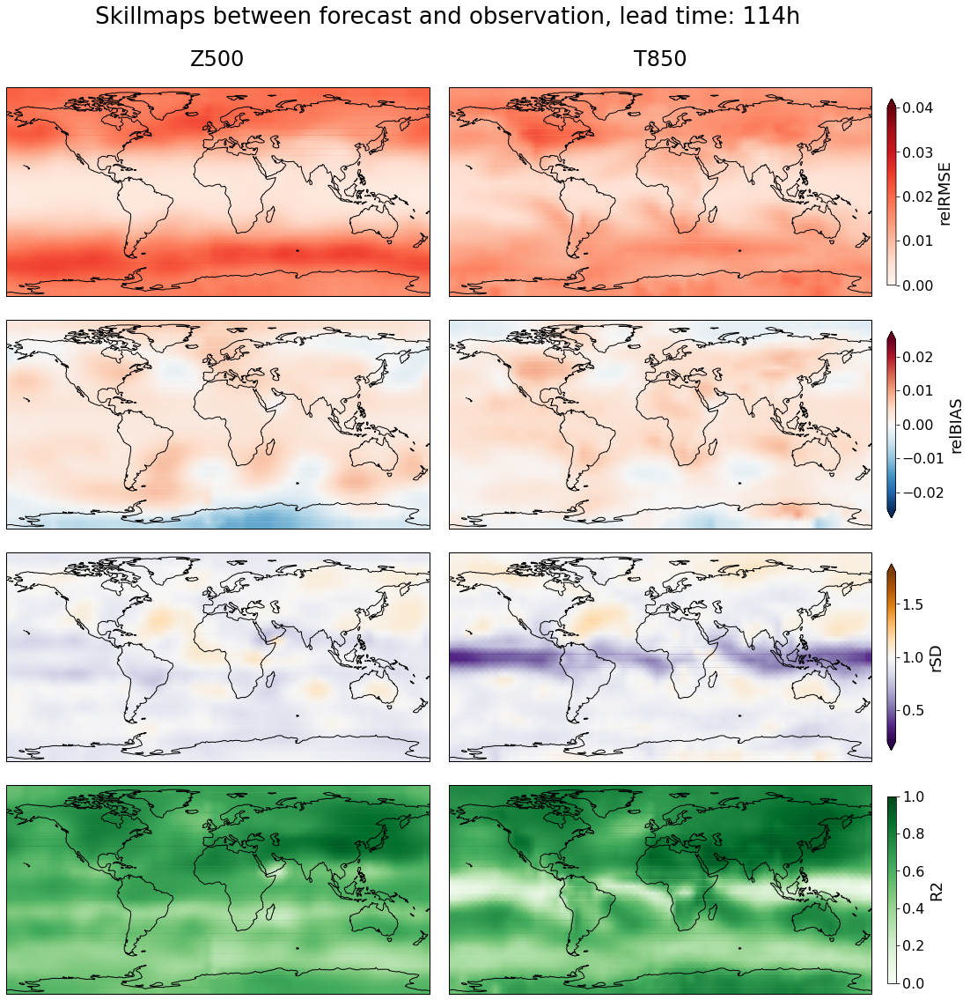

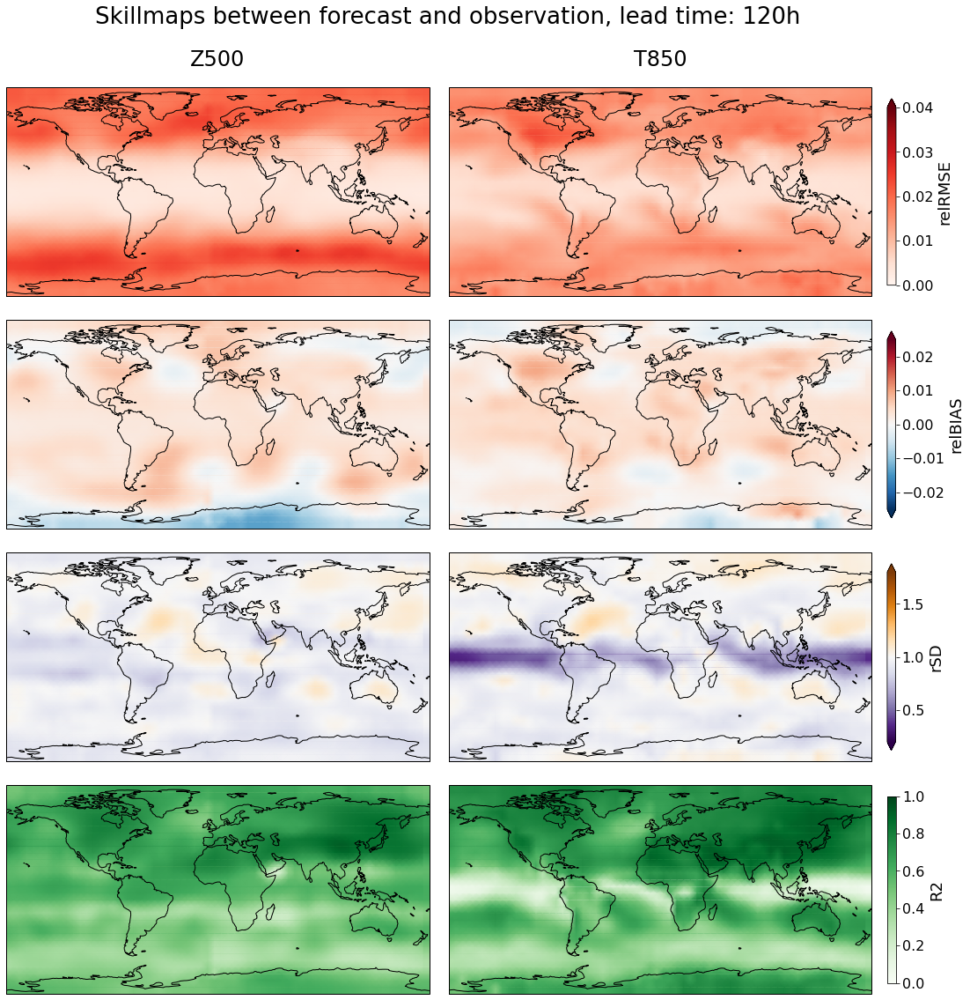

In [34]:
plot_general_skills(rmse_map_norm, corr_map, rbias_map, rsd_map, description, lead_times, 
                    output_dir=figures_path, title=False)

plot_skillmaps(rmse_map_norm, rsd_map, rbias_map, corr_map, description, lead_times, resolution, 
               output_dir=figures_path)

Climatology Hovmoller

In [35]:
monthly_mean = pred.groupby('time.month').mean().compute()
monthly_mean_obs = obs.groupby('time.month').mean().compute()

In [36]:
lead_idx = 19

# Computations
monthly_mean.isel(lead_time=lead_idx)
monthly_mean_eq = []
for month in range(12):
    monthly_mean_eq.append(hp_to_equiangular(monthly_mean.isel(lead_time=lead_idx, month=month), 
                                     resolution))
monthly_mean_eq = xr.concat(monthly_mean_eq, pd.Index(np.arange(1, 13, 1), name='month'))
monthly_lat_eq = monthly_mean_eq.mean('lon')

monthly_mean_obs.isel(lead_time=lead_idx)
monthly_mean_eq_obs = []
for month in range(12):
    monthly_mean_eq_obs.append(hp_to_equiangular(monthly_mean_obs.isel(lead_time=lead_idx, month=month), 
                                     resolution))
monthly_mean_eq_obs = xr.concat(monthly_mean_eq_obs, pd.Index(np.arange(1, 13, 1), name='month'))
monthly_lat_eq_obs = monthly_mean_eq_obs.mean('lon')

pred_z = np.rot90(monthly_lat_eq.z.values, 3)
pred_t = np.rot90(monthly_lat_eq.t.values, 3)
obs_z = np.rot90(monthly_lat_eq_obs.z.values, 3)
obs_t = np.rot90(monthly_lat_eq_obs.t.values, 3)

diff_z = pred_z / obs_z
diff_t = pred_t / obs_t

# Labels and limits
ticks = np.linspace(0, 31, 7).astype(int)
lat_labels = np.linspace(-90, 90, 7).astype(int)
month_labels = ['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec']

vmin_z = min(np.min(monthly_lat_eq.z).values.flatten()[0], np.min(monthly_lat_eq_obs.z).values.flatten()[0])
vmax_z = max(np.max(monthly_lat_eq.z).values.flatten()[0], np.max(monthly_lat_eq_obs.z).values.flatten()[0])
vmin_t = min(np.min(monthly_lat_eq.t).values.flatten()[0], np.min(monthly_lat_eq_obs.t).values.flatten()[0])
vmax_t = max(np.max(monthly_lat_eq.t).values.flatten()[0], np.max(monthly_lat_eq_obs.t).values.flatten()[0])

delta = min((np.min(diff_z)-1), (1-np.max(diff_z)), (np.min(diff_t)-1), (1-np.max(diff_t)))

vmin_sd = 1 - delta
vmax_sd = 1 + delta

In [37]:
predictions_vals = {'pred_z': pred_z, 'pred_t': pred_t,'obs_z': obs_z,'obs_t': obs_t}
val_limits = {'vmin_z':vmin_z, 'vmax_z':vmax_z, 'vmin_t':vmin_t, \
              'vmax_t':vmax_t, 'vmin_sd':vmin_sd, 'vmax_sd':vmax_sd}

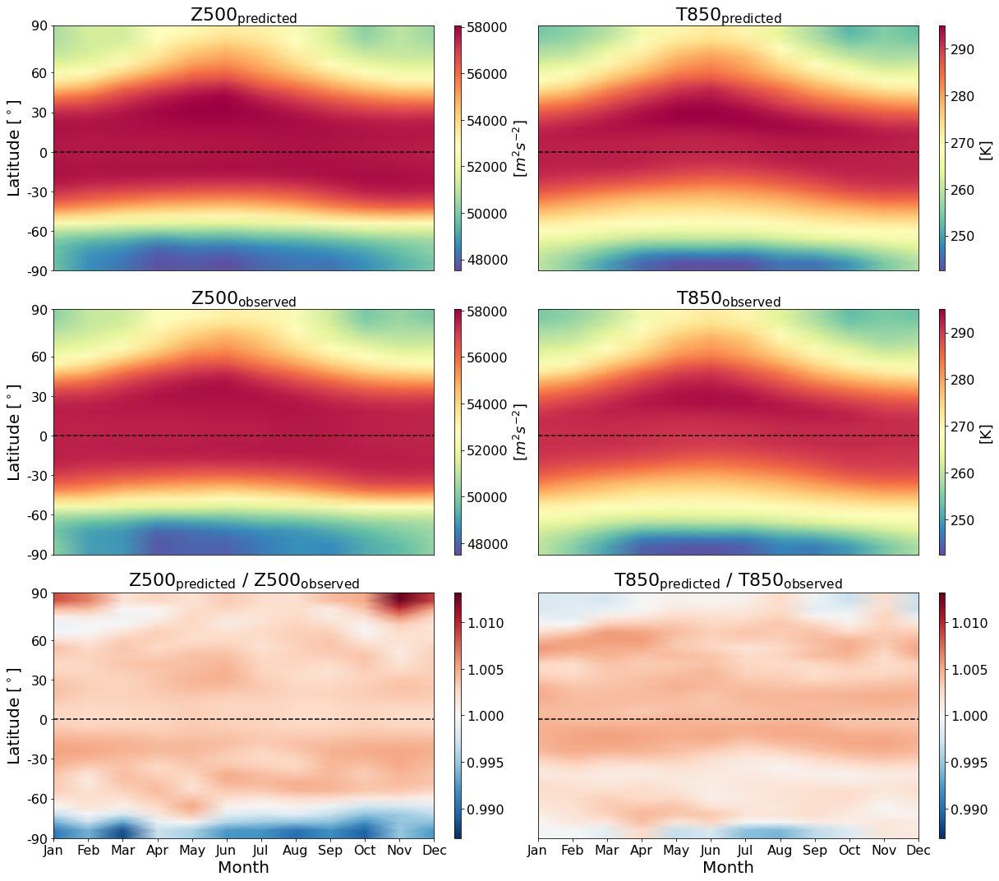

In [38]:
 
figname = figures_path + description + '_hovmoller'
plot_climatology(figname, predictions_vals, val_limits, ticks, lat_labels, month_labels)

In [39]:
iterations = [w[2] for w in weight_variations]
epochs = [w[1] for w in weight_variations]

iterations_ = np.array(iterations) #+ iterations_per_epoch*np.array(epochs)

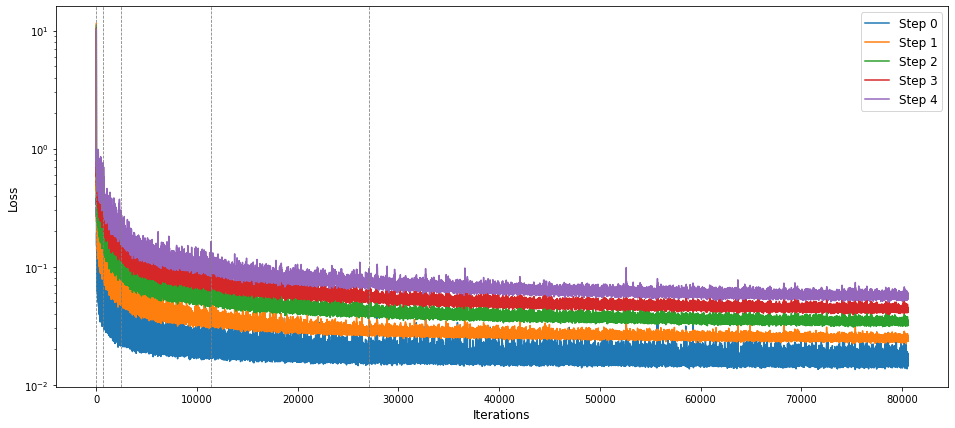

In [40]:
plt.figure(figsize=(16,7))
for i in range(5):
    plt.plot(train_loss_steps['t{}'.format(i)], label='Step {}'.format(i))

for x in iterations_:
    plt.axvline(x, linestyle='--', linewidth=0.8, color='grey')
plt.yscale('log')
plt.legend(fontsize=12)
plt.xlabel('Iterations', fontsize=12)
plt.ylabel('Loss', fontsize=12)
plt.savefig(figures_path + 'loss_evolution.png')
plt.show()

In [41]:
import json

In [42]:
with open("../modules/confMail.json") as json_data_file:
    mailConf = json.load(json_data_file)

mail = {
    "sender": mailConf["sender"],
    "receiver": mailConf["sender"],
    "subject": "Finished training!",
    "body": "Finished training model {}.\n Losses: \nZ500: t0 \t{}\t t120 \t{}\nt850: t0 \t{}\t t120 \t{} "\
    .format(description, rmse_spherical.z[0].values, rmse_spherical.z[-1].values, rmse_spherical.t[0].values, rmse_spherical.t[-1].values),
    "fileAttaching": "Yes",
    "file": [figures_path + 'loss_evolution.png', figures_path + description + '_benchmark.png', \
             figures_path + description + '_general_skills.png', \
             figures_path + description + '_0_maps.png', figures_path + description + '_19_maps.png',]


}
send_info_mail(mailInfo=mail, configFile=mailConf)

In [43]:
#import IPython

#IPython.Application.instance().kernel.do_shutdown(True)